In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip "/content/drive/MyDrive/Datasets/chessred2k.zip" -d "."


Archive:  /content/drive/MyDrive/Datasets/chessred2k.zip
   creating: ./images/
   creating: ./images/0/
  inflating: ./images/0/G000_IMG000.jpg  
  inflating: ./images/0/G000_IMG001.jpg  
  inflating: ./images/0/G000_IMG002.jpg  
  inflating: ./images/0/G000_IMG003.jpg  
  inflating: ./images/0/G000_IMG004.jpg  
  inflating: ./images/0/G000_IMG005.jpg  
  inflating: ./images/0/G000_IMG006.jpg  
  inflating: ./images/0/G000_IMG007.jpg  
  inflating: ./images/0/G000_IMG008.jpg  
  inflating: ./images/0/G000_IMG009.jpg  
  inflating: ./images/0/G000_IMG010.jpg  
  inflating: ./images/0/G000_IMG011.jpg  
  inflating: ./images/0/G000_IMG012.jpg  
  inflating: ./images/0/G000_IMG013.jpg  
  inflating: ./images/0/G000_IMG014.jpg  
  inflating: ./images/0/G000_IMG015.jpg  
  inflating: ./images/0/G000_IMG016.jpg  
  inflating: ./images/0/G000_IMG017.jpg  
  inflating: ./images/0/G000_IMG018.jpg  
  inflating: ./images/0/G000_IMG019.jpg  
  inflating: ./images/0/G000_IMG020.jpg  
  inflating: 

In [ ]:
!cp "drive/MyDrive/Datasets/annotations.json" -d "."

In [ ]:
import json

# Path to the JSON file
json_path = "annotations.json"

# Load the JSON file
with open(json_path, 'r') as f:
    anns = json.load(f)

In [ ]:
import os
import json
import cv2

# === 1. Load the annotations ===
with open('/content/annotations.json', 'r') as f:
    anns = json.load(f)

images_dict = {img['id']: img['path'] for img in anns['images']}
categories = {cat['id']: cat['name'] for cat in anns['categories'] if cat['name'] != 'empty'}
splits = anns['splits']
pieces_ann = anns['annotations']['pieces']

# === 2. Set output paths ===
base_output = '/content/drive/MyDrive/ChessReD/yolo_format'
splits_list = ['train', 'val', 'test']

for split in splits_list:
    os.makedirs(os.path.join(base_output, 'images', split), exist_ok=True)
    os.makedirs(os.path.join(base_output, 'labels', split), exist_ok=True)

# === 3. Prepare YOLO annotations ===
i=0
for split in splits_list:
    image_ids = splits[split]['image_ids']
    for img_id in image_ids:
        img_filename = images_dict[img_id]


        img_path = f'/content/{img_filename}'

        img = cv2.imread(img_path)



        if img is None:

            continue
        else:
          i=i+1
          print(i)
        h, w = img.shape[:2]


        img=cv2.resize(img,(512,512))



        yolo_lines = []

        # Filter pieces for this image
        for ann in pieces_ann:
            if ann['image_id'] != img_id:
                continue

            class_id = ann['category_id']
            if class_id == 12:  # Skip 'empty'
                continue

            x_min, y_min, box_w, box_h = ann['bbox']
            x_center = (x_min + box_w / 2) / w
            y_center = (y_min + box_h / 2) / h
            norm_w = box_w / w
            norm_h = box_h / h

            yolo_lines.append(f"{class_id} {x_center:.6f} {y_center:.6f} {norm_w:.6f} {norm_h:.6f}")

        # Save image
        split_img_path = os.path.join(base_output, 'images', split, str(img_id)+'.png')

        cv2.imwrite(split_img_path, img)


        # Save labels
        label_filename = str(img_id)+'.txt'

        label_path = os.path.join(base_output, 'labels', split, label_filename)
        with open(label_path, 'w') as f:
            f.write('\n'.join(yolo_lines))


In [ ]:

base_output = '/content/drive/MyDrive/ChessReD/yolo_format'
data_yaml = f"""
train: {base_output}/images/train
val: {base_output}/images/val
test: {base_output}/images/test

nc: 12
names: {list(categories.values())}
"""

with open(f'{base_output}/data.yaml', 'w') as f:
    f.write(data_yaml)


In [ ]:
!pip install ultralytics


In [ ]:
from ultralytics import YOLO

# Load a pretrained model
model = YOLO('yolov8n.pt')  # or yolov8s.pt for more accuracy




Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 6.25M/6.25M [00:00<00:00, 117MB/s]


In [ ]:
# Train on your data
model.train(data='/content/drive/MyDrive/ChessReD/yolo_format/data.yaml', epochs=10, imgsz=512, batch=16)

Ultralytics 8.3.151 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/ChessReD/yolo_format/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=512, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=Tr

100%|██████████| 755k/755k [00:00<00:00, 20.5MB/s]

Overriding model.yaml nc=80 with nc=12

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

Model summary: 129 layers, 3,013,188 parameters, 3,013,172 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 93.1MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.5±0.2 ms, read: 0.9±0.3 MB/s, size: 470.2 KB)


train: Scanning /content/drive/MyDrive/ChessReD/yolo_format/labels/train... 1442 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1442/1442 [12:45<00:00,  1.88it/s]


train: New cache created: /content/drive/MyDrive/ChessReD/yolo_format/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.8±0.8 ms, read: 0.4±0.2 MB/s, size: 435.4 KB)


val: Scanning /content/drive/MyDrive/ChessReD/yolo_format/labels/val... 330 images, 0 backgrounds, 0 corrupt: 100%|██████████| 330/330 [02:11<00:00,  2.51it/s]

val: New cache created: /content/drive/MyDrive/ChessReD/yolo_format/labels/val.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000625, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10       1.4G       1.07      3.242     0.9128         34        512: 100%|██████████| 91/91 [00:31<00:00,  2.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04<00:00,  2.31it/s]

                   all        330       6132      0.374       0.38      0.364      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      1.72G     0.7346      1.306     0.8269         39        512: 100%|██████████| 91/91 [00:27<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04<00:00,  2.49it/s]


                   all        330       6132      0.627      0.666      0.688      0.545

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      1.75G     0.6211     0.8616     0.8115         41        512: 100%|██████████| 91/91 [00:26<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04<00:00,  2.26it/s]


                   all        330       6132      0.785      0.806      0.833      0.689

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      1.75G     0.5618     0.7062     0.8045         45        512: 100%|██████████| 91/91 [00:27<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03<00:00,  2.81it/s]

                   all        330       6132      0.846      0.854      0.917      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      1.76G     0.5336     0.6095     0.8009         44        512: 100%|██████████| 91/91 [00:26<00:00,  3.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04<00:00,  2.70it/s]


                   all        330       6132      0.902      0.904      0.958      0.794

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      1.76G     0.5009     0.5521     0.7969         49        512: 100%|██████████| 91/91 [00:26<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:05<00:00,  2.15it/s]


                   all        330       6132      0.933      0.915      0.968      0.776

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      1.76G     0.4873     0.5163     0.7948         24        512: 100%|██████████| 91/91 [00:27<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03<00:00,  2.86it/s]


                   all        330       6132      0.953      0.928      0.977      0.798

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      1.76G       0.48     0.4992     0.7934         52        512: 100%|██████████| 91/91 [00:27<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:04<00:00,  2.73it/s]


                   all        330       6132       0.94      0.943       0.98       0.82

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      1.76G     0.4675     0.4822     0.7921         58        512: 100%|██████████| 91/91 [00:27<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:03<00:00,  3.01it/s]


                   all        330       6132      0.956      0.941      0.983      0.829

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      1.76G     0.4554     0.4668     0.7912         49        512: 100%|██████████| 91/91 [00:27<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:05<00:00,  2.11it/s]


                   all        330       6132      0.965       0.95      0.985      0.813

10 epochs completed in 0.091 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.151 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,988 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 11/11 [00:07<00:00,  1.40it/s]


                   all        330       6132      0.956      0.941      0.983      0.829
            white-pawn        330       1625      0.993      0.988      0.995      0.814
            white-rook        281        447      0.991      0.993      0.995      0.819
          white-knight        220        274      0.985      0.928      0.987      0.821
          white-bishop        235        335       0.99      0.924       0.99      0.828
           white-queen        126        126      0.819      0.937       0.96      0.847
            white-king        330        330      0.966      0.957       0.99      0.871
            black-pawn        330       1511      0.983      0.982      0.994      0.825
            black-rook        280        471      0.981      0.981      0.994      0.858
          black-knight        125        178      0.929       0.91      0.962      0.761
          black-bishop        223        380      0.982       0.86      0.977      0.814
           black-quee

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7aaf225a0810>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,  

In [ ]:
model.save('/content/drive/MyDrive/ChessReD/fineuned-yolo.pt')

In [ ]:
from ultralytics import YOLO
model = YOLO("/content/drive/MyDrive/ChessReD/fineuned-yolo.pt")

In [ ]:
metrics = model.val(split='test')  # Evaluates on the validation set in the data.yaml file
  # Optional: view the evaluation metrics

Ultralytics 8.3.151 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,988 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 5.7±11.7 ms, read: 1.0±0.5 MB/s, size: 481.3 KB)


val: Scanning /content/drive/MyDrive/ChessReD/yolo_format/labels/test.cache... 306 images, 0 backgrounds, 0 corrupt: 100%|██████████| 306/306 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:10<00:00,  1.90it/s]


                   all        306       6294      0.957      0.946      0.983      0.829
            white-pawn        304       1624      0.992      0.981      0.994      0.791
            white-rook        271        433      0.988      0.986      0.991      0.828
          white-knight        192        278      0.961      0.965      0.979       0.81
          white-bishop        172        304      0.962      0.947      0.987      0.863
           white-queen        160        160      0.867      0.869      0.944      0.844
            white-king        306        306      0.929      0.948      0.987      0.832
            black-pawn        306       1719      0.989      0.981      0.995      0.822
            black-rook        272        433      0.991      0.983      0.995      0.825
          black-knight        189        278      0.938      0.926      0.979      0.788
          black-bishop        159        296      0.982      0.908      0.984      0.827
           black-quee

In [ ]:
print('mean average precision50 : ' , metrics.box.map50)
print('mean precision : ' ,metrics.box.mp)
print('mean recall: ' ,metrics.box.mr)

mean average precision50 :  0.9830470507080178
mean precision :  0.9568713348539787
mean recall:  0.9462628255123177



image 1/1 /content/drive/MyDrive/ChessReD/yolo_format/images/test/3967.png: 512x512 4 white-pawns, 1 white-rook, 2 white-bishops, 1 white-king, 5 black-pawns, 1 black-rook, 2 black-bishops, 1 black-king, 6.9ms
Speed: 1.5ms preprocess, 6.9ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)


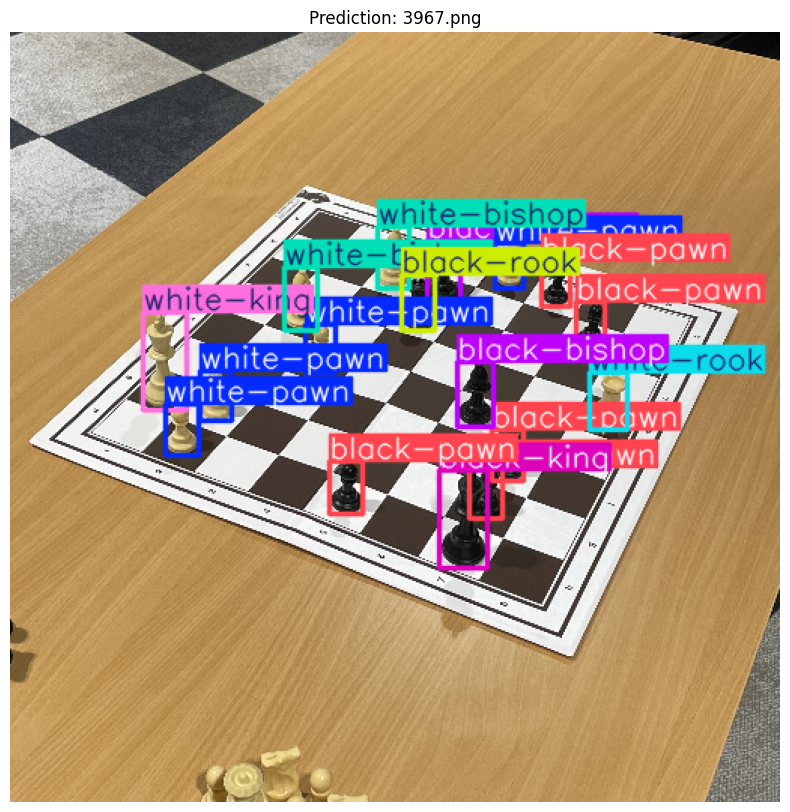


image 1/1 /content/drive/MyDrive/ChessReD/yolo_format/images/test/32.png: 512x512 4 white-pawns, 2 white-rooks, 3 white-knights, 2 white-bishops, 1 white-queen, 1 white-king, 6 black-pawns, 2 black-rooks, 2 black-knights, 3 black-queens, 1 black-king, 11.9ms
Speed: 2.1ms preprocess, 11.9ms inference, 2.4ms postprocess per image at shape (1, 3, 512, 512)


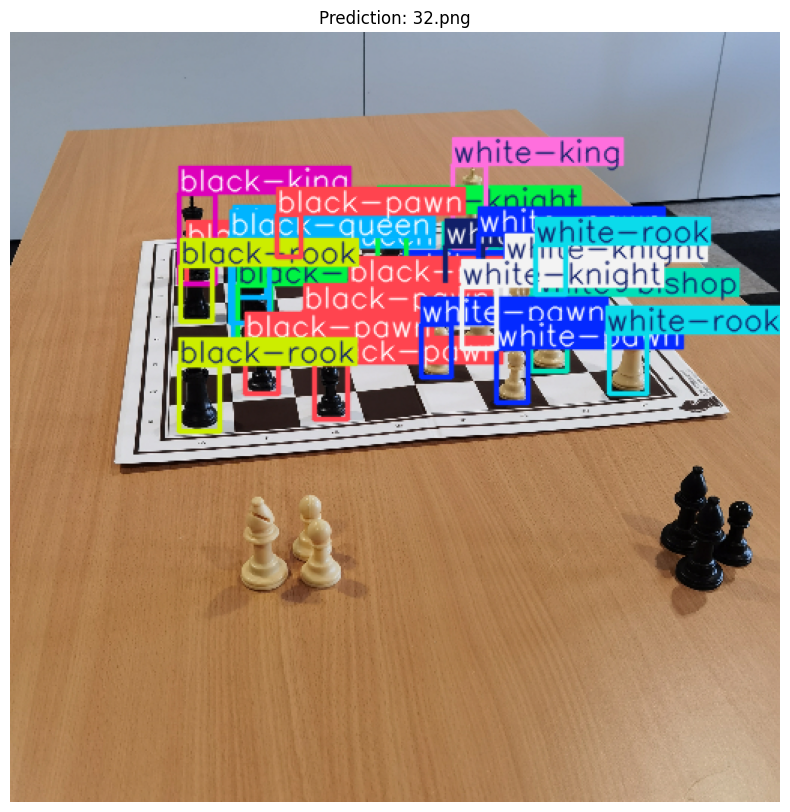


image 1/1 /content/drive/MyDrive/ChessReD/yolo_format/images/test/97.png: 512x512 1 white-pawn, 1 white-rook, 1 white-king, 3 black-pawns, 1 black-rook, 1 black-king, 11.1ms
Speed: 2.0ms preprocess, 11.1ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 512)


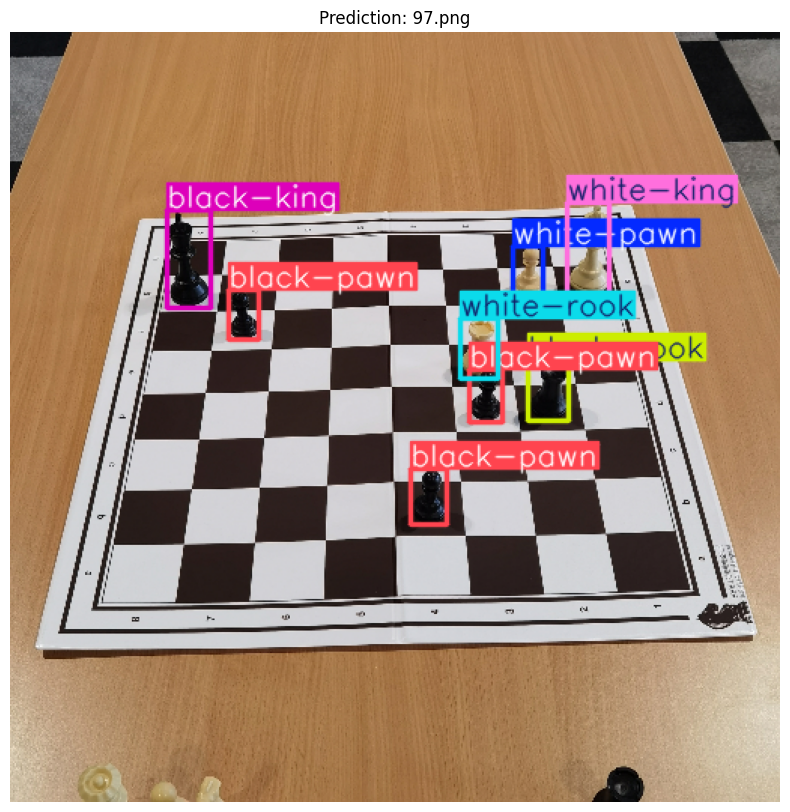


image 1/1 /content/drive/MyDrive/ChessReD/yolo_format/images/test/8462.png: 512x512 5 white-pawns, 1 white-rook, 1 white-king, 4 black-pawns, 1 black-rook, 1 black-king, 15.1ms
Speed: 2.0ms preprocess, 15.1ms inference, 4.2ms postprocess per image at shape (1, 3, 512, 512)


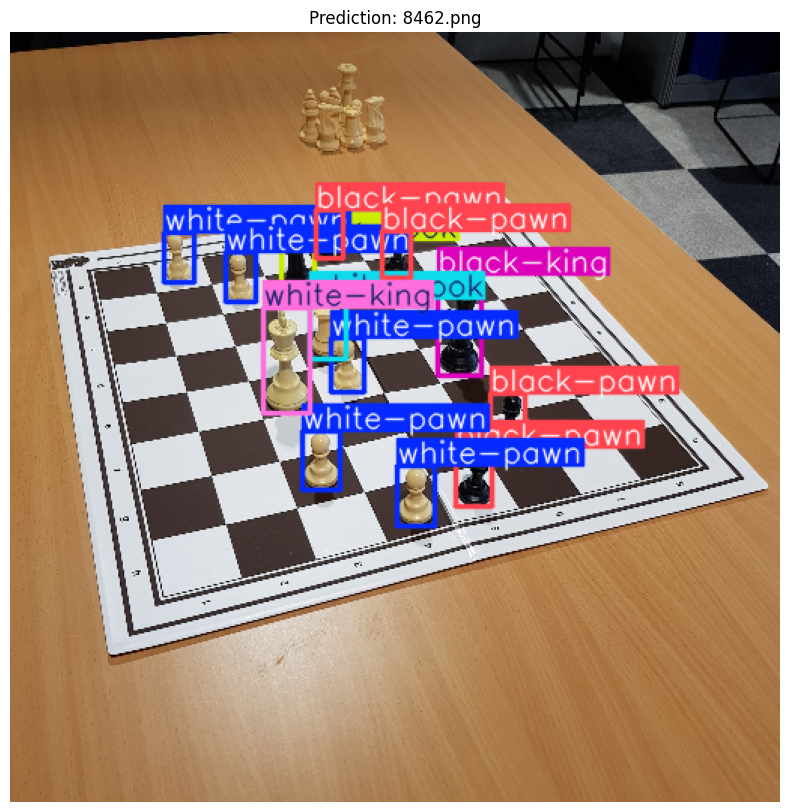


image 1/1 /content/drive/MyDrive/ChessReD/yolo_format/images/test/3914.png: 512x512 9 white-pawns, 2 white-rooks, 2 white-knights, 2 white-bishops, 4 white-queens, 3 white-kings, 8 black-pawns, 2 black-rooks, 2 black-knights, 2 black-bishops, 1 black-queen, 1 black-king, 12.1ms
Speed: 2.1ms preprocess, 12.1ms inference, 2.5ms postprocess per image at shape (1, 3, 512, 512)


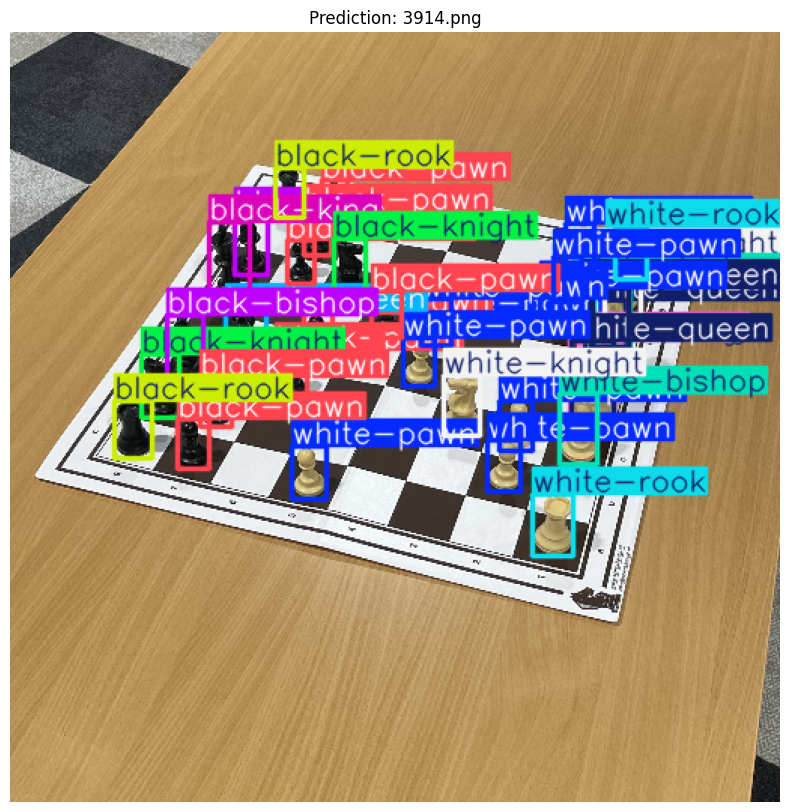

In [ ]:
import os
import random
import cv2
import matplotlib.pyplot as plt

test_img_dir = '/content/drive/MyDrive/ChessReD/yolo_format/images/test'  # Use test set
sample_images = random.sample(os.listdir(test_img_dir), 5)  # Select 5 random images

for img_file in sample_images:
    img_path = os.path.join(test_img_dir, img_file)
    results = model(img_path)  # Predict

    # Plot with smaller font and thinner boxes
    img_with_boxes = results[0].plot(
        conf=False,           # Hide confidence score
        labels=True,

    )

    # Display image using matplotlib
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(img_with_boxes, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title(f"Prediction: {img_file}")
    plt.show()


Digital twin


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO

# === CONFIGURATION ===
YOLO_MODEL_PATH = "/content/drive/MyDrive/ChessReD/fineuned-yolo.pt"
reference_img = '/content/G000_IMG062.jpg'

# === 1. Load Image ===
def load_and_preprocess(image_path):
    img = cv2.imread(image_path)
    if img is None:
        print(f"Error loading {image_path}")
        return None
    img = cv2.resize(img, (800, 800))
    return img

def match_luminosity(target_img, reference_img):
    target_lab = cv2.cvtColor(target_img, cv2.COLOR_BGR2LAB).astype(np.float32)
    l_target, a_target, b_target = cv2.split(target_lab)
    mean_ref, std_ref = 131.02156, 64.48178
    mean_tar, std_tar = l_target.mean(), l_target.std()
    l_matched = (l_target - mean_tar) * (std_ref / (std_tar + 1e-8)) + mean_ref
    l_matched = np.clip(l_matched, 0, 255)
    matched_lab = cv2.merge([l_matched, a_target, b_target]).astype(np.uint8)
    matched_bgr = cv2.cvtColor(matched_lab, cv2.COLOR_LAB2BGR)

    # Visualization: matched luminosity result
    plt.figure(figsize=(6, 6))
    plt.title("Original Image")
    plt.imshow(cv2.cvtColor(matched_bgr, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

    return matched_bgr

# === 2. Detect Chessboard Corners ===
def detect_chessboard_corners(img):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 15, 255])
    mask = cv2.inRange(hsv, lower_white, upper_white)
    edges = cv2.Canny(mask, 50, 150, apertureSize=3)

    lines = cv2.HoughLinesP(edges, 1, np.pi/180, 100, minLineLength=50, maxLineGap=10)
    if lines is None:
        return None

    vis_img = img.copy()
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv2.line(vis_img, (x1, y1), (x2, y2), (0, 255, 0), 1)



    def line_intersection(line1, line2):
        x1, y1, x2, y2 = line1
        x3, y3, x4, y4 = line2
        det = (x1 - x2) * (y3 - y4) - (y1 - y2) * (x3 - x4)
        if abs(det) < 3000:
            return None
        px = ((x1*y2 - y1*x2) * (x3 - x4) - (x1 - x2) * (x3*y4 - y3*x4)) / det
        py = ((x1*y2 - y1*x2) * (y3 - y4) - (y1 - y2) * (x3*y4 - y3*x4)) / det
        return int(px), int(py)

    bounding_box = []
    for i in range(len(lines)):
        for j in range(i + 1, len(lines)):
            point = line_intersection(lines[i][0], lines[j][0])
            if point:
                bounding_box.append(point)

    if len(bounding_box) < 4:
        return None

    def fit_quadrilateral(bounding_box, img_shape):
        h, w = img_shape[:2]
        points = np.array([p for p in bounding_box if 0 <= p[0] < w and 0 <= p[1] < h], dtype=np.float32)
        if len(points) < 4:
            return None
        hull = cv2.convexHull(points)
        epsilon = 0.02 * cv2.arcLength(hull, True)
        approx = cv2.approxPolyDP(hull, epsilon, True)
        if len(approx) < 4:
            return None
        return approx.reshape(-1, 2)

    def order_corners(corners):
        corners = sorted(corners, key=lambda x: x[1])
        top_two = sorted(corners[:2], key=lambda x: x[0])
        bottom_two = sorted(corners[2:], key=lambda x: x[0])
        return np.array([top_two[0], top_two[1], bottom_two[1], bottom_two[0]], dtype=np.float32)

    corners = order_corners(fit_quadrilateral(bounding_box, img.shape))

    vis_corners = img.copy()
    for i, pt in enumerate(corners):
        cv2.circle(vis_corners, tuple(pt.astype(int)), 10, (0, 0, 255), -1)
        cv2.putText(vis_corners, f"{i}", tuple(pt.astype(int)), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2)



    return corners

# === 3. Get Perspective Transform ===
def get_warped_board(image, corners, board_size=800):
    dst_pts = np.array([
        [0, 0],
        [board_size - 1, 0],
        [board_size - 1, board_size - 1],
        [0, board_size - 1]
    ], dtype=np.float32)
    M = cv2.getPerspectiveTransform(corners.astype(np.float32), dst_pts)
    warped = cv2.warpPerspective(image, M, (board_size, board_size))

    plt.figure(figsize=(6, 6))
    plt.title("Warped Chessboard")
    plt.imshow(cv2.cvtColor(warped, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

    return warped, M

# === 4. Run YOLO to Detect Pieces ===
def detect_pieces_yolo(image):
    model = YOLO(YOLO_MODEL_PATH)
    results = model(image)[0]

    img_h, img_w = image.shape[:2]
    detections = []
    vis_img=image.copy()

    for box in results.boxes:
        x1n, y1n, x2n, y2n = box.xyxyn[0].cpu().numpy()  # normalized coords
        cls_id = int(box.cls[0].item())
        label = model.names[cls_id]

        # Convert normalized coordinates to pixel values
        x1, y1, x2, y2 = x1n * img_w, y1n * img_h, x2n * img_w, y2n * img_h

        # Only use the bottom third of the bounding box to compute the center
        bottom_third_y1 = y1 + 2 * (y2 - y1) / 3
        cx = (x1 + x2) / 2
        cy = (bottom_third_y1 + y2) / 2  # center of the bottom third

        detections.append({'label': label, 'center': (cx, cy)})



        cv2.rectangle(vis_img, (int(x1n*img_w), int(y1n*img_h)), (int(x2n*img_w), int(y2n*img_h)), (0, 255, 0), 2)
        cv2.putText(vis_img, label, (int(cx), int(cy)), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)


    return detections

# === 5. Map Points to Squares ===
def get_square_for_point(pt, board_size=640):
    square_size = board_size // 8
    x, y = pt
    col = int(x // square_size)
    row = int(y // square_size)
    row = min(max(row, 0), 7)
    col = min(max(col, 0), 7)
    return row, col


def visualize_detections_with_centers(image, detections, window_name="Detections"):
    vis_img = image.copy()
    for det in detections:
        cx, cy = int(det["center"][0]), int(det["center"][1])
        label = det["label"]
        cv2.circle(vis_img, (cx, cy), radius=5, color=(0, 255, 0), thickness=-1)
        cv2.putText(vis_img, label, (cx + 5, cy - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)
    plt.figure(figsize=(8, 8))
    plt.imshow(cv2.cvtColor(vis_img, cv2.COLOR_BGR2RGB))
    plt.title(window_name)
    plt.axis('off')
    plt.show()


# === 6. Full Pipeline ===
def get_chessboard_matrix(image_path):
    image = match_luminosity(load_and_preprocess(image_path), reference_img)
    corners = detect_chessboard_corners(image)
    warped_board, M = get_warped_board(image, corners)
    detections = detect_pieces_yolo(image)
    visualize_detections_with_centers(image, detections)

    Minv = np.linalg.inv(M)
    board_matrix = np.full((8, 8), "empty", dtype=object)

    for det in detections:
        cx, cy = det["center"]
        center_pt = np.array([[[cx, cy]]], dtype=np.float32)
        mapped_pt = cv2.perspectiveTransform(center_pt, M)
        x_t, y_t = mapped_pt[0][0]
        x_t -= 55
        y_t -= 55

        if not (0 <= x_t < 690 and 0 <= y_t < 690):
            continue

        row, col = get_square_for_point((x_t, y_t), board_size=690)
        board_matrix[row][col] = det["label"]

    return board_matrix

import cv2
import numpy as np
import os

def generate_chessboard_image(board_matrix, square_size=80, piece_img_dir='pieces'):
    """
    Creates an image of a digital chessboard from a board_matrix.

    Args:
        board_matrix (np.ndarray): 8x8 array with entries like 'white-king', 'empty', etc.
        square_size (int): Pixel size of each square.
        piece_img_dir (str): Path to folder containing piece PNGs.

    Returns:
        np.ndarray: Image of the board.
    """
    board_size = square_size * 8
    board_img = np.zeros((board_size, board_size, 3), dtype=np.uint8)

    # Colors for squares
    light_color = (240, 217, 181)  # light brown
    dark_color = (181, 136, 99)    # dark brown

    for row in range(8):
        for col in range(8):
            y1, y2 = row * square_size, (row + 1) * square_size
            x1, x2 = col * square_size, (col + 1) * square_size

            square_color = light_color if (row + col) % 2 == 0 else dark_color
            cv2.rectangle(board_img, (x1, y1), (x2, y2), square_color, thickness=-1)

            piece = board_matrix[row][col]
            if piece != "empty":
                piece_path = os.path.join(piece_img_dir, f"{piece}.png")
                if os.path.exists(piece_path):
                    piece_img = cv2.imread(piece_path, cv2.IMREAD_UNCHANGED)
                    if piece_img is None:
                        continue
                    piece_img = cv2.resize(piece_img, (square_size, square_size))

                    # Handle alpha blending if image has transparency
                    if piece_img.shape[2] == 4:  # RGBA
                        alpha = piece_img[:, :, 3] / 255.0
                        for c in range(3):
                            board_img[y1:y2, x1:x2, c] = (
                                alpha * piece_img[:, :, c] +
                                (1 - alpha) * board_img[y1:y2, x1:x2, c]
                            ).astype(np.uint8)
                    else:
                        board_img[y1:y2, x1:x2] = piece_img

    return board_img


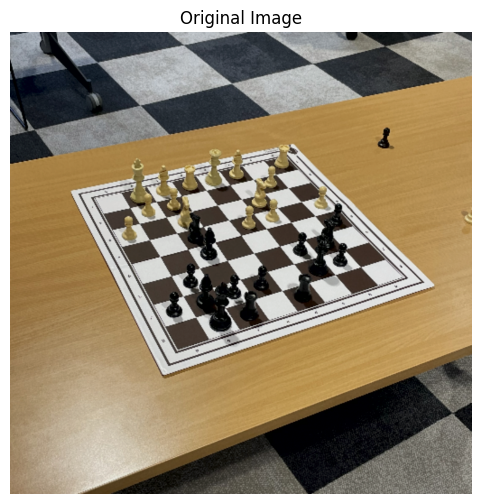

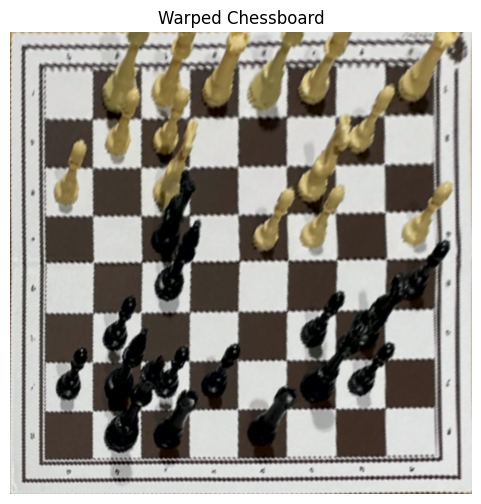


0: 512x512 7 white-pawns, 2 white-rooks, 2 white-knights, 2 white-bishops, 1 white-queen, 1 white-king, 7 black-pawns, 2 black-rooks, 3 black-knights, 2 black-bishops, 1 black-queen, 1 black-king, 8.8ms
Speed: 2.9ms preprocess, 8.8ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 512)


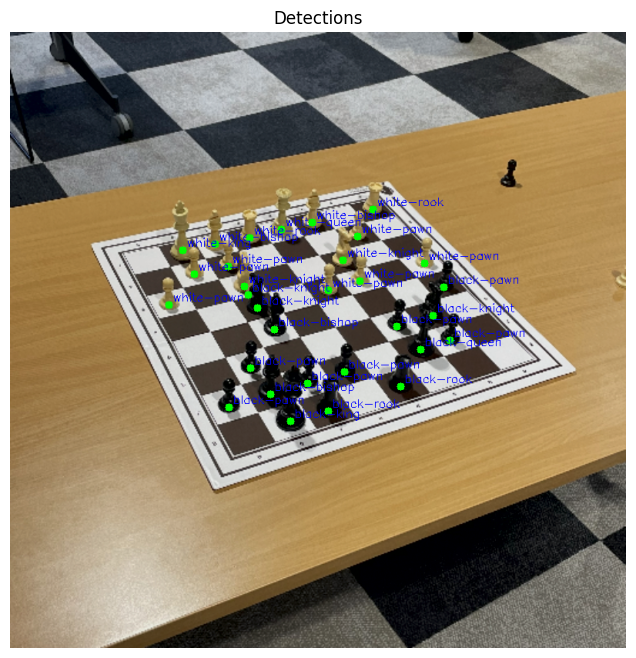

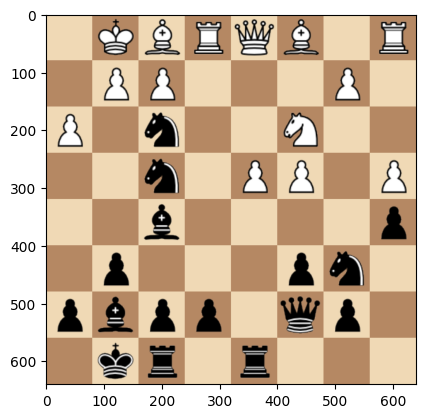

In [ ]:
image_path='/content/drive/MyDrive/ChessReD/yolo_format/images/train/3400.png'
board = get_chessboard_matrix(image_path)
board_img = generate_chessboard_image(board,piece_img_dir='/content/drive/MyDrive/pieces')
plt.imshow(board_img)

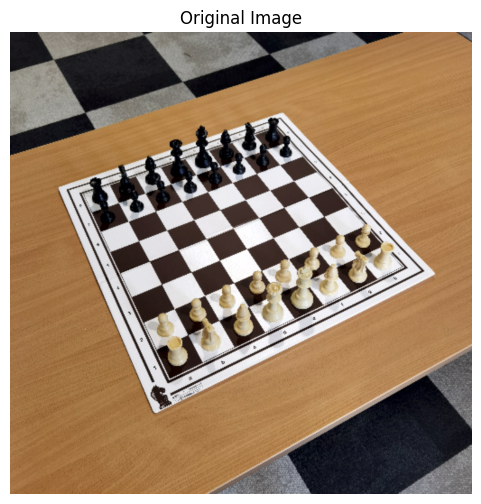

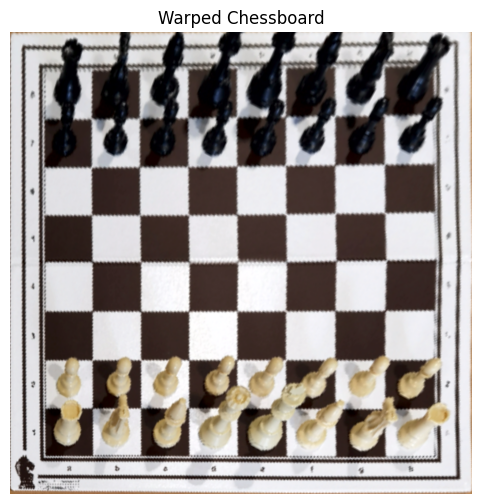


0: 512x512 8 white-pawns, 2 white-rooks, 3 white-knights, 1 white-bishop, 2 white-queens, 1 white-king, 8 black-pawns, 2 black-rooks, 2 black-knights, 2 black-bishops, 1 black-queen, 1 black-king, 8.7ms
Speed: 3.2ms preprocess, 8.7ms inference, 1.7ms postprocess per image at shape (1, 3, 512, 512)


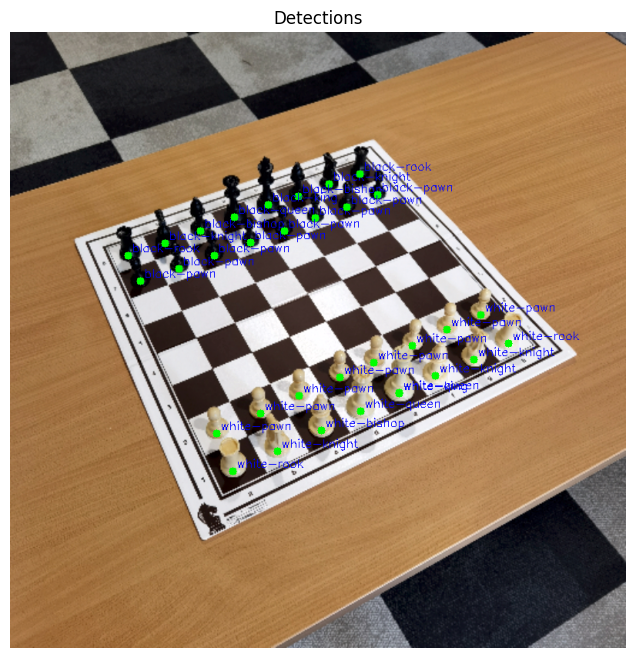

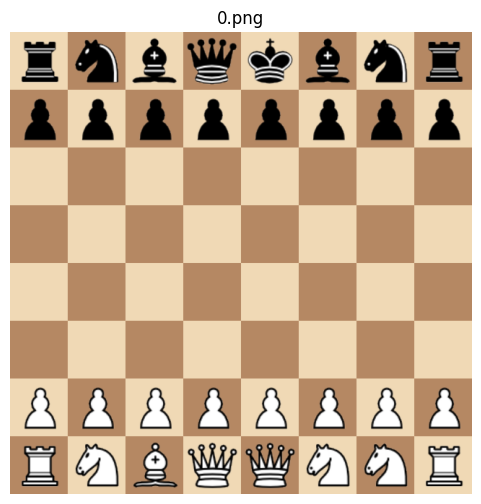

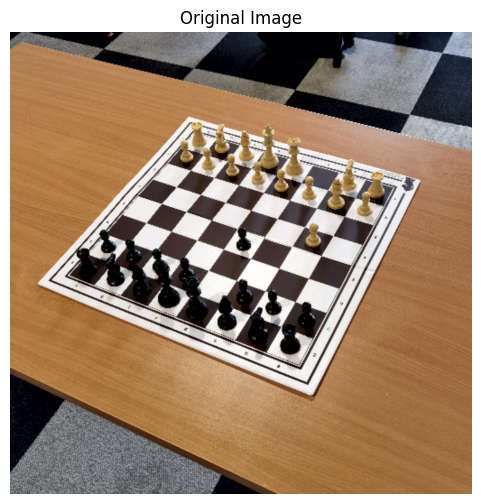

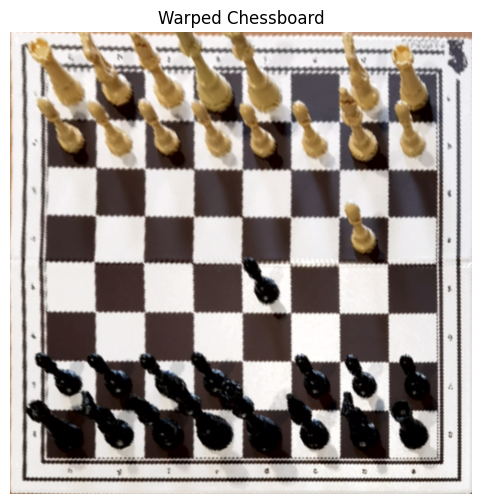


0: 512x512 8 white-pawns, 2 white-rooks, 2 white-knights, 2 white-bishops, 1 white-queen, 1 white-king, 8 black-pawns, 2 black-rooks, 2 black-knights, 2 black-bishops, 1 black-queen, 1 black-king, 8.5ms
Speed: 3.4ms preprocess, 8.5ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 512)


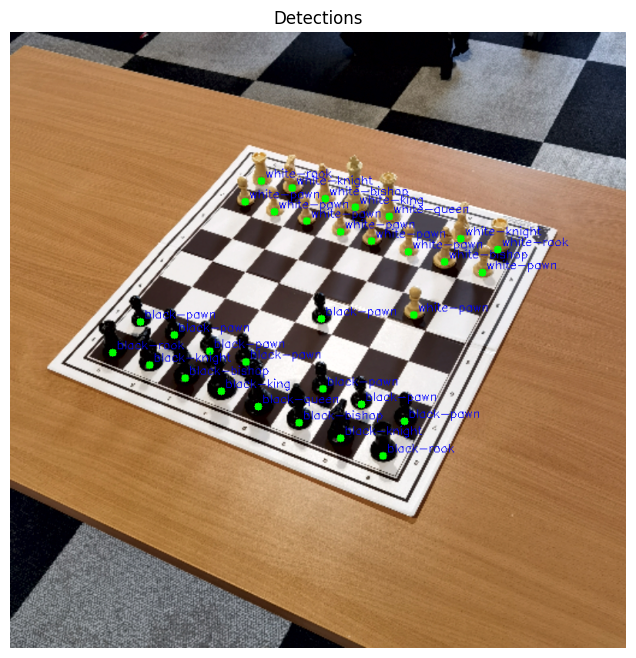

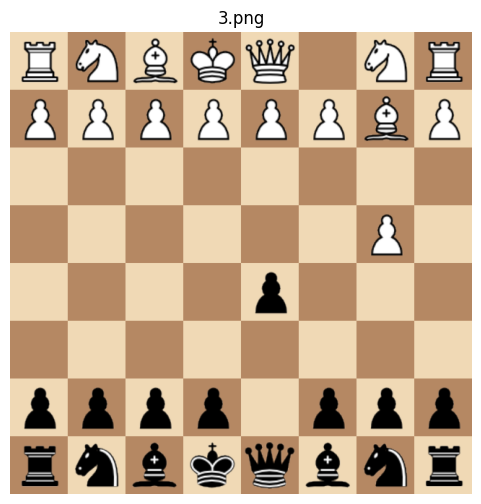

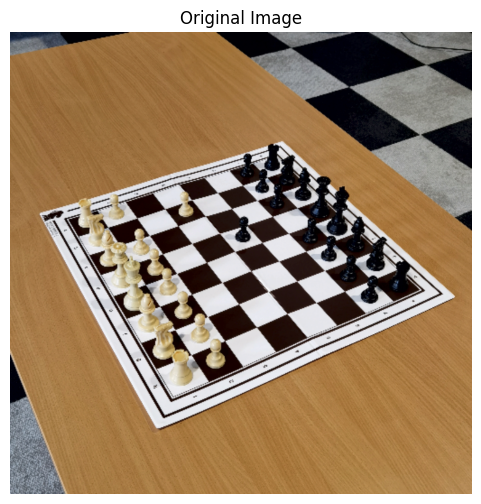

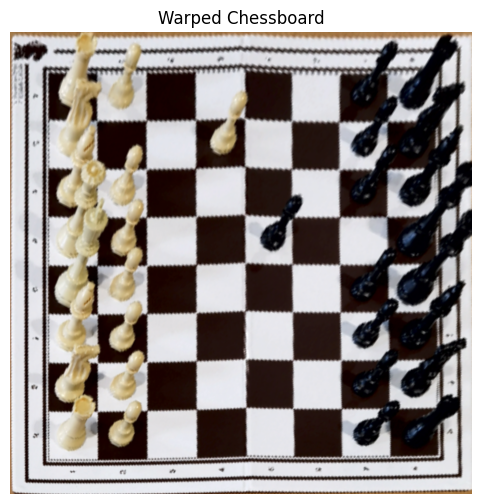


0: 512x512 8 white-pawns, 2 white-rooks, 2 white-knights, 2 white-bishops, 1 white-queen, 1 white-king, 8 black-pawns, 3 black-rooks, 2 black-knights, 2 black-bishops, 1 black-queen, 1 black-king, 8.0ms
Speed: 3.5ms preprocess, 8.0ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 512)


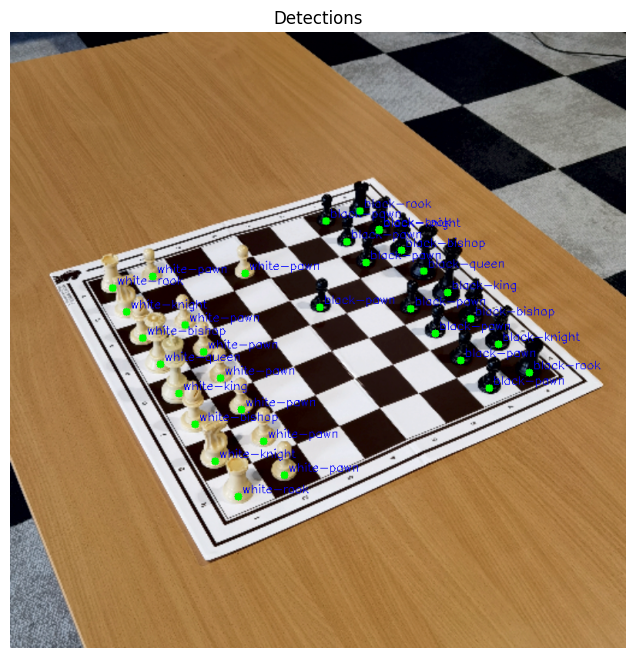

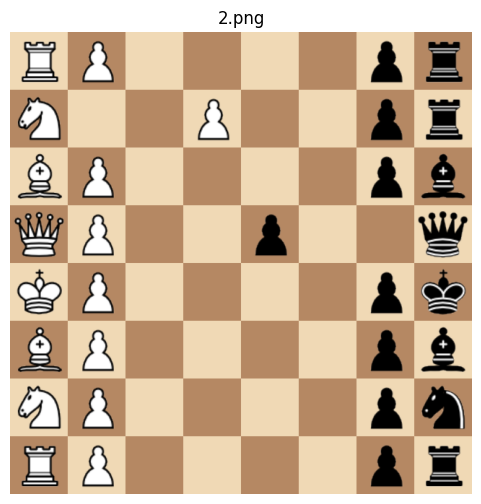

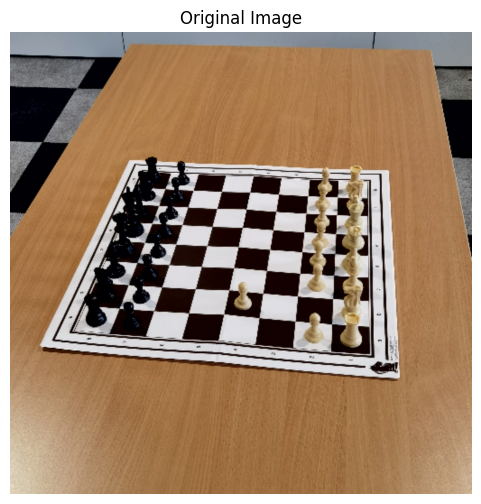

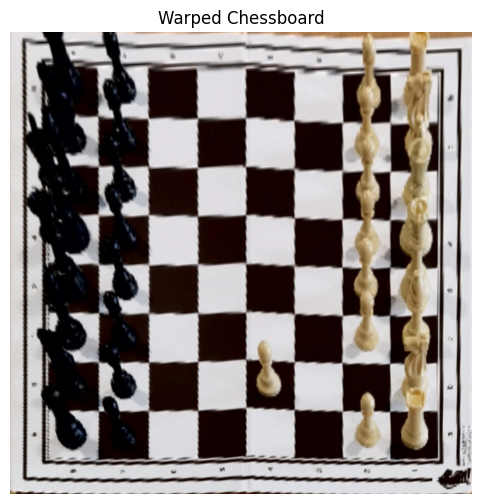


0: 512x512 8 white-pawns, 2 white-rooks, 1 white-knight, 3 white-bishops, 1 white-king, 8 black-pawns, 2 black-rooks, 2 black-knights, 2 black-bishops, 3 black-queens, 1 black-king, 8.6ms
Speed: 3.8ms preprocess, 8.6ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


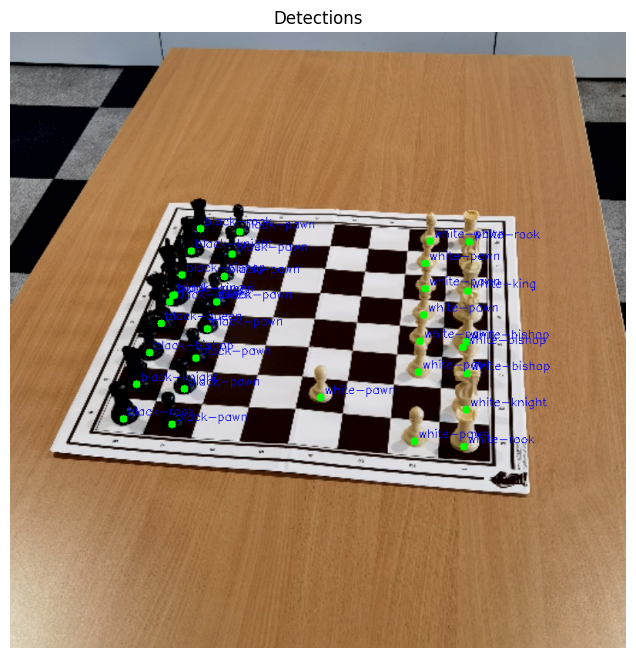

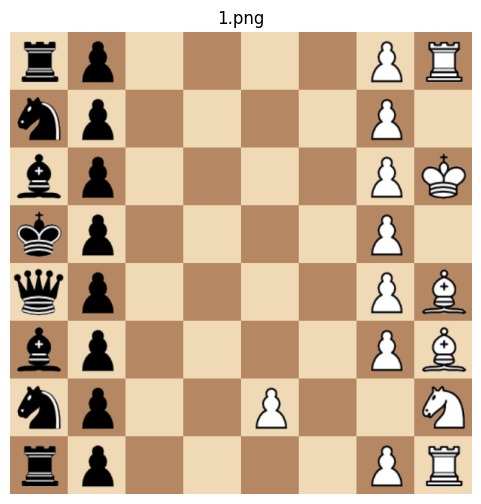

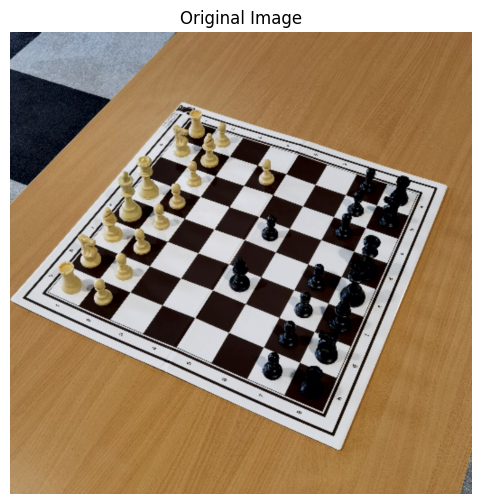

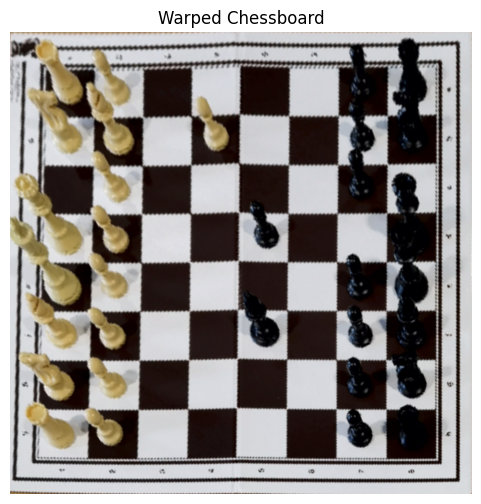


0: 512x512 8 white-pawns, 2 white-rooks, 2 white-knights, 2 white-bishops, 1 white-queen, 1 white-king, 8 black-pawns, 3 black-rooks, 2 black-knights, 2 black-bishops, 2 black-queens, 1 black-king, 7.8ms
Speed: 4.6ms preprocess, 7.8ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


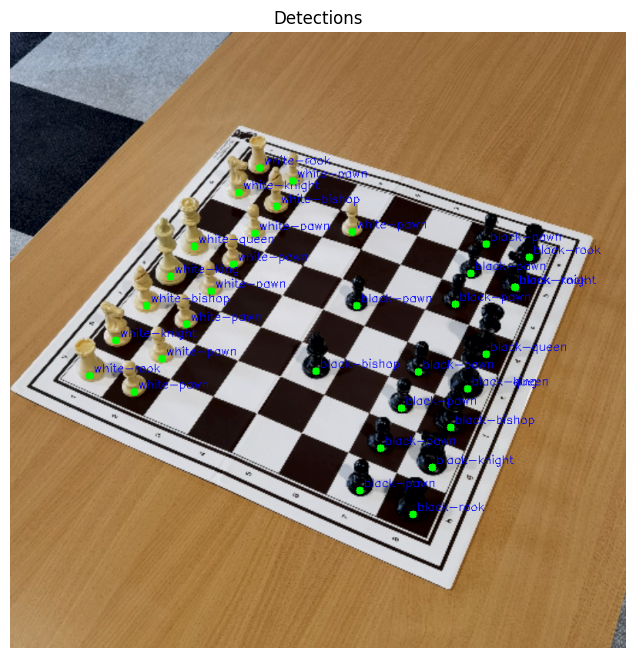

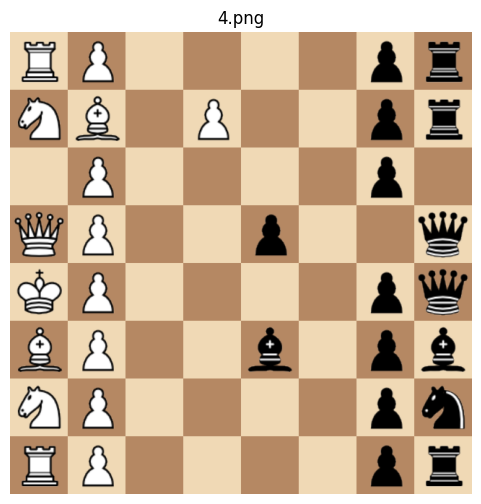

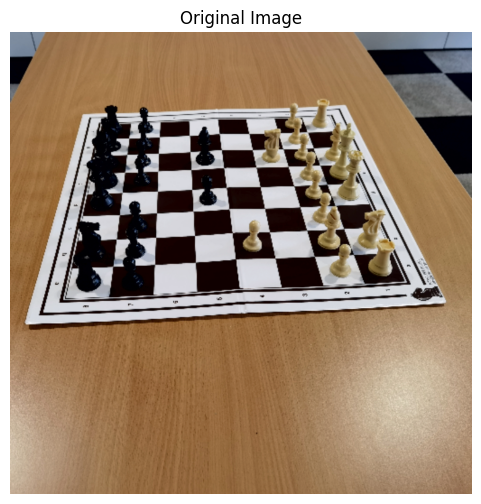

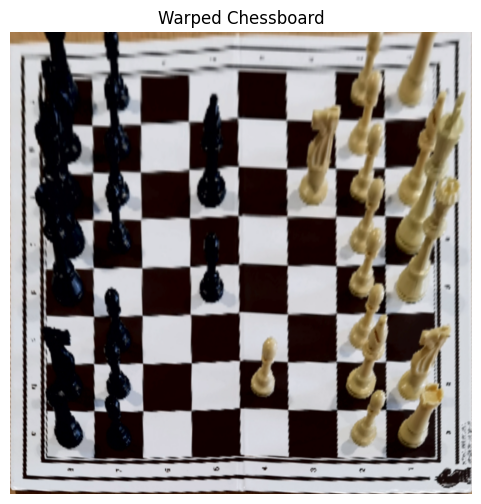


0: 512x512 10 white-pawns, 2 white-rooks, 2 white-knights, 2 white-bishops, 1 white-queen, 1 white-king, 10 black-pawns, 2 black-rooks, 2 black-knights, 4 black-bishops, 2 black-queens, 2 black-kings, 9.9ms
Speed: 3.4ms preprocess, 9.9ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 512)


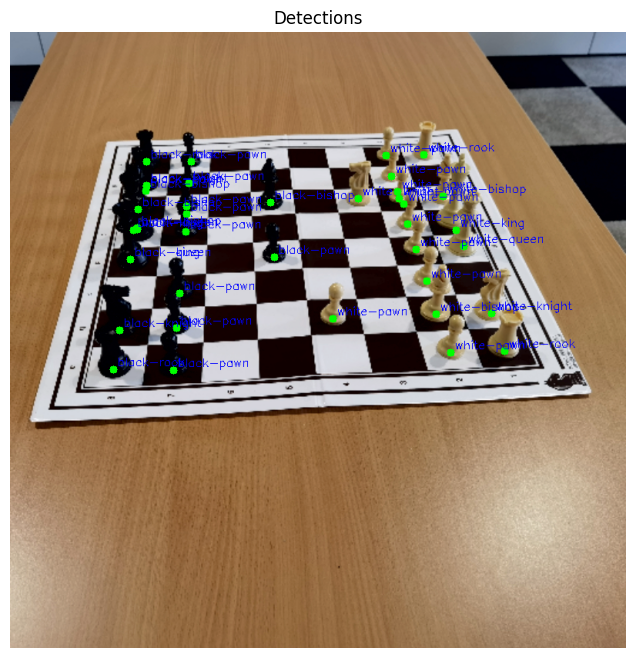

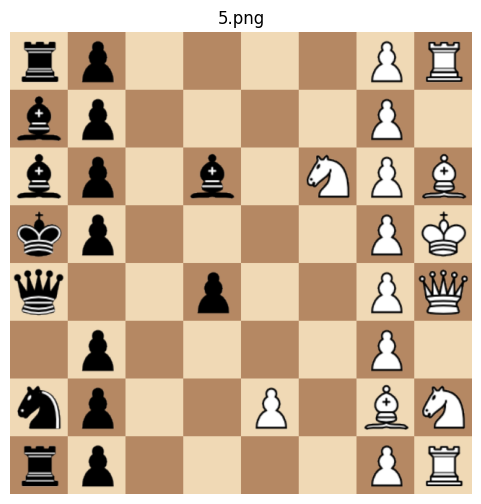

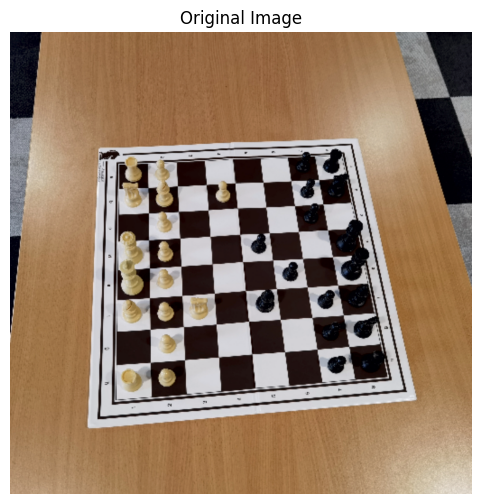

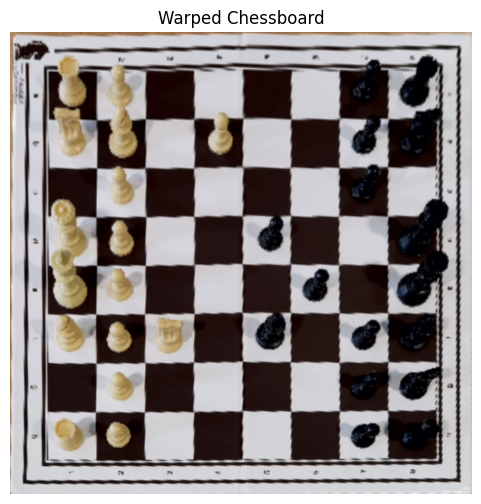


0: 512x512 9 white-pawns, 5 white-rooks, 2 white-knights, 1 white-bishop, 1 white-king, 10 black-pawns, 1 black-rook, 1 black-knight, 3 black-bishops, 1 black-king, 8.3ms
Speed: 3.4ms preprocess, 8.3ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


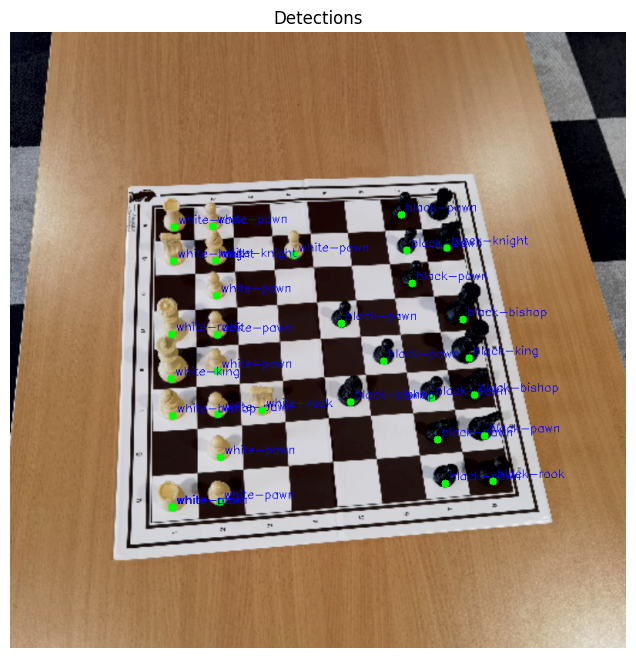

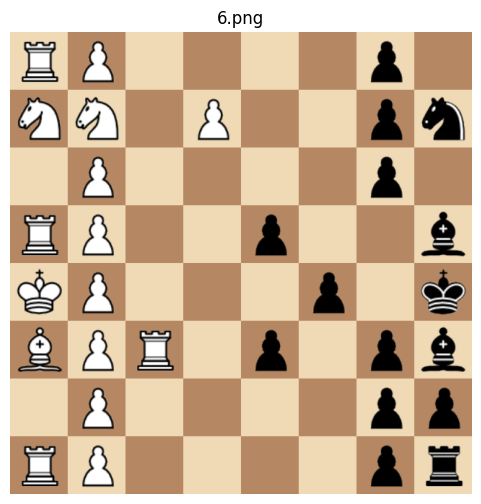

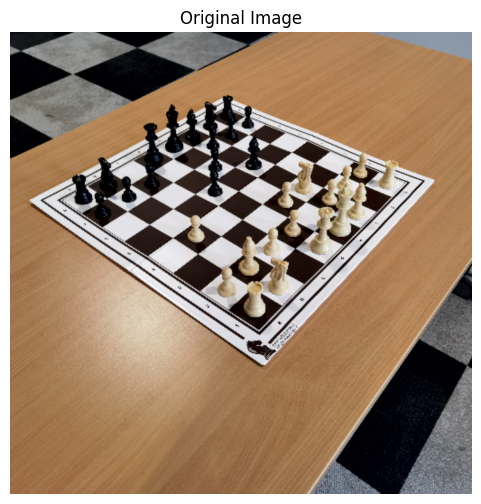

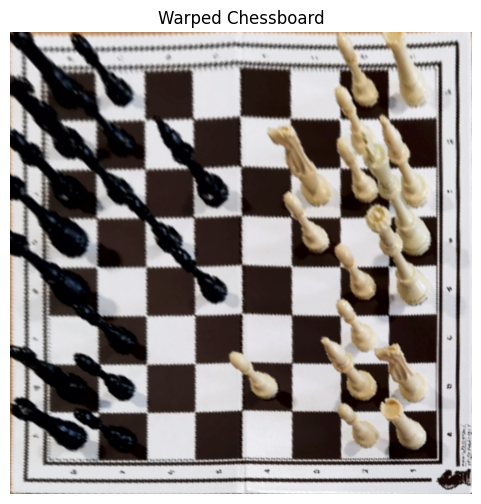


0: 512x512 8 white-pawns, 2 white-rooks, 2 white-knights, 2 white-bishops, 1 white-queen, 1 white-king, 8 black-pawns, 2 black-rooks, 2 black-knights, 2 black-bishops, 1 black-queen, 1 black-king, 13.3ms
Speed: 3.4ms preprocess, 13.3ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 512)


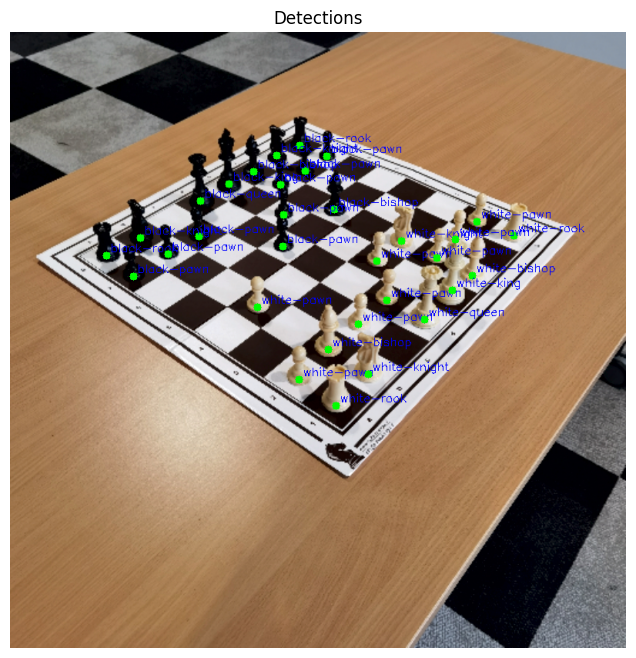

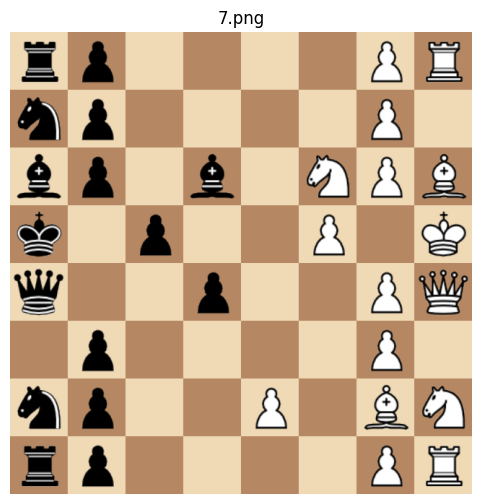

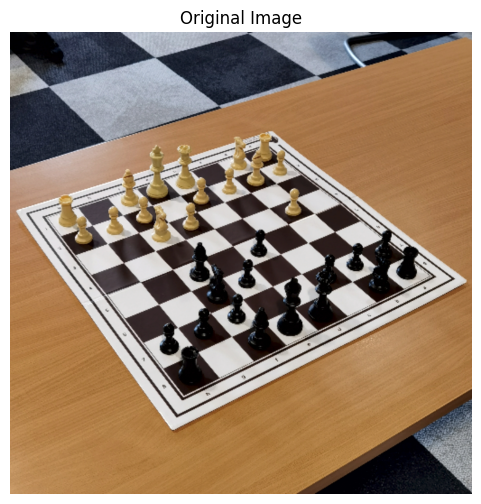

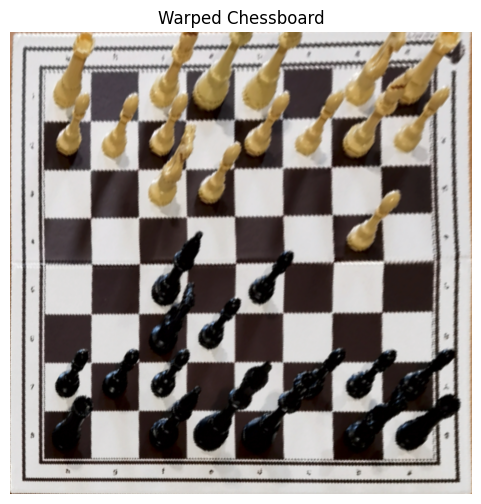


0: 512x512 8 white-pawns, 2 white-rooks, 2 white-knights, 2 white-bishops, 1 white-queen, 1 white-king, 8 black-pawns, 2 black-rooks, 2 black-knights, 2 black-bishops, 1 black-queen, 1 black-king, 11.8ms
Speed: 3.4ms preprocess, 11.8ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 512)


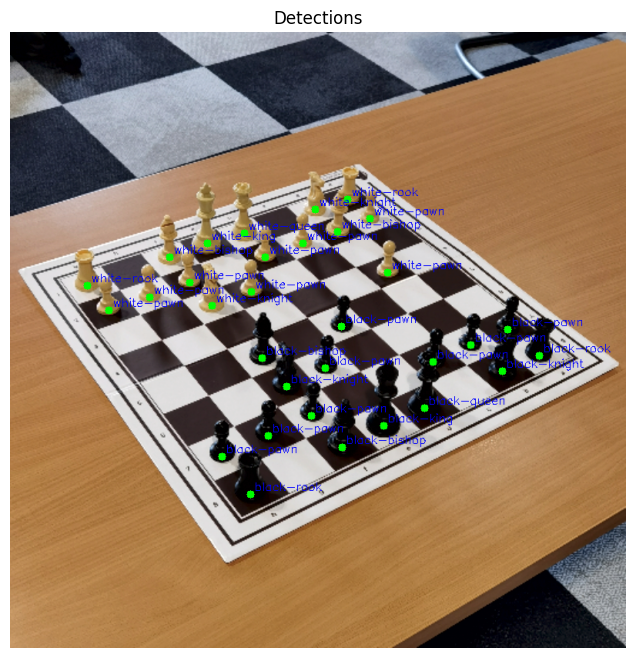

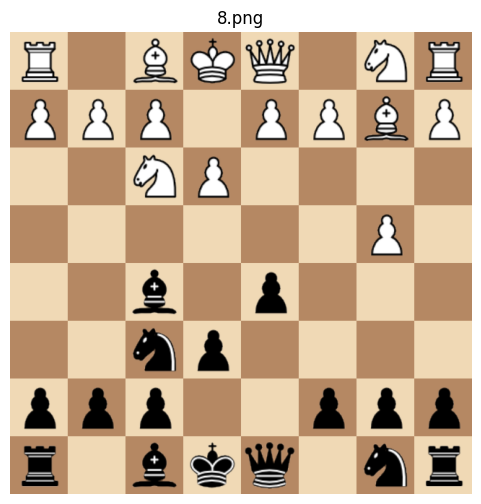

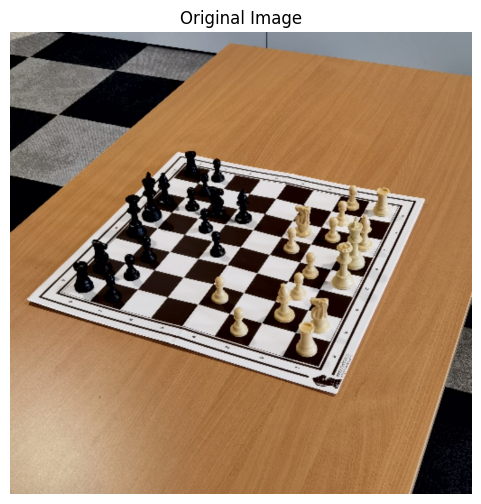

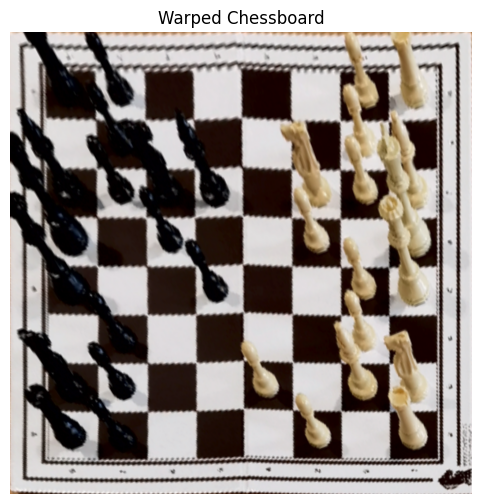


0: 512x512 9 white-pawns, 2 white-rooks, 3 white-knights, 2 white-bishops, 1 white-queen, 8 black-pawns, 2 black-rooks, 3 black-knights, 3 black-bishops, 1 black-queen, 1 black-king, 13.5ms
Speed: 3.6ms preprocess, 13.5ms inference, 2.0ms postprocess per image at shape (1, 3, 512, 512)


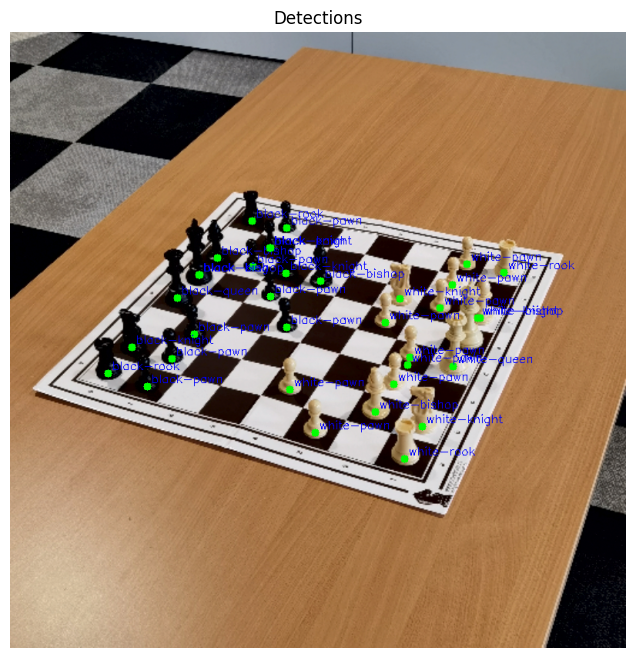

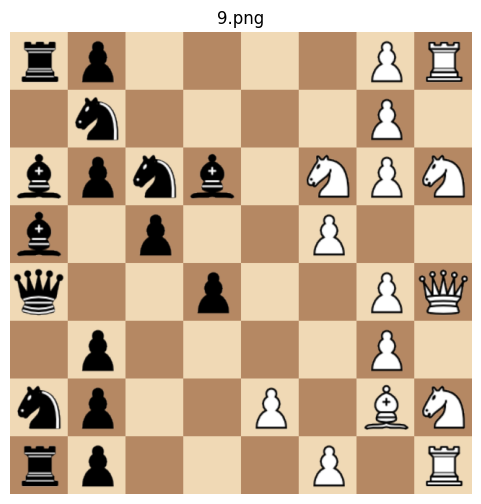

In [ ]:
import os
import matplotlib.pyplot as plt

image_dir = '/content/drive/MyDrive/ChessReD/yolo_format/images/test/'
piece_img_dir = '/content/drive/MyDrive/pieces'

# Get list of image paths and sort them
image_files = [
    f for f in os.listdir(image_dir)
    if f.lower().endswith(('.png', '.jpg', '.jpeg'))
][:10]  # Take the first 10

for image_file in image_files:
    image_path = os.path.join(image_dir, image_file)

    board = get_chessboard_matrix(image_path)
    board_img = generate_chessboard_image(board, piece_img_dir=piece_img_dir)

    plt.figure(figsize=(6, 6))
    plt.title(image_file)
    plt.imshow(board_img)
    plt.axis('off')
    plt.show()
